In [ ]:
!pip install --quiet --upgrade comet_ml
from comet_ml import Experiment

# Create an experiment with your api key:
experiment = Experiment(
    api_key="lUoLdpDugeusAkGaqqXhj9bZO",
    project_name="final-project",
    workspace="tama-ts",
)

COMET INFO: ---------------------------
COMET INFO: Comet.ml Experiment Summary
COMET INFO: ---------------------------
COMET INFO:   Data:
COMET INFO:     display_summary_level : 1
COMET INFO:     url                   : https://www.comet.ml/tama-ts/final-project/6b3445ad80ee40c1a3a142063e314bac
COMET INFO:   Metrics [count] (min, max):
COMET INFO:     loss [253]            : (0.1767672747373581, 0.21766316890716553)
COMET INFO:     train_mse_loss [2526] : (0.17206540703773499, 0.22303476929664612)
COMET INFO:   Others [count]:
COMET INFO:     Name [2] : 4 layers encoder, Normed data!, 20 epochs, lr = 0.00001, bot_neck = 50 (radical measures!), batch_size = 20 (was 50), new otimizer - SGD with nesterov momentum(now 0.5)
COMET INFO:   Uploads:
COMET INFO:     environment details : 1
COMET INFO:     filename            : 1
COMET INFO:     installed packages  : 1
COMET INFO:     model graph         : 1
COMET INFO:     os packages         : 1
COMET INFO: ---------------------------
COMET 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
imgs1 = np.load('/content/drive/My Drive/data/part_000.npz')
imgs2 = np.load('/content/drive/My Drive/data/part_0001.npz')

In [ ]:
lst1 = imgs1.files
lst2 = imgs2.files

In [ ]:
a1 = imgs1[lst1[2]]
a2 = imgs2[lst2[2]]

In [ ]:
mz1 = imgs1[lst1[1]]
mz2 = imgs2[lst2[1]]

In [ ]:
len(a2)

1794

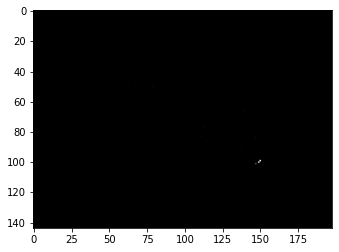

In [ ]:
plt.imshow(a2[10], cmap = 'gray')

In [ ]:
a2.shape

(1794, 144, 198)

In [ ]:
data1 = a1.reshape(a1.shape[0], -1)
data2 = a2.reshape(a2.shape[0], -1)

In [ ]:
data2.shape

(1794, 28512)

Images from the first set are almost the same and would bias all the calculations. I thought they could be usefull for augmentations but VAE can perform well without them so I decided not to risk.

### Imports

In [ ]:
from sklearn.cluster import KMeans, DBSCAN, OPTICS
from collections import Counter
from sklearn.metrics import silhouette_score
from tqdm import tqdm

## Custom functions

Functions that will help us to show the results of clustering.

In [ ]:
def show_cluster(data, labels, no_cluster):
    cluster = tuple([labels==no_cluster])
    clust_ims = data[cluster]
    if np.sum(cluster) > 12:
        ks = 12
        fig, ax = plt.subplots(ncols=4, nrows = 12//4, figsize=(20, 10))
    else:
        ks = np.sum(cluster)
        fig, ax = plt.subplots(ncols=4, nrows = ks//4+1, figsize=(20, 10))
    for i in range(ks):
        ax[i//4, i%4].imshow(clust_ims[i], cmap = 'gray')
        ax[i//4, i%4].axis('off')
    plt.suptitle("Claster No. {0}".format(no_cluster), fontsize=16)

In [ ]:
def clusters_preview(data, labels, n_cl=''):
    cls = np.unique(labels)
    if len(cls) < 5:
        ip = len(cls)
        fig, ax = plt.subplots(ncols=ip, nrows = 1, figsize=(20,4))
        ax = ax.reshape(1,-1)
    else:
        ip = len(cls)
        if ip%4==0:
            fig, ax = plt.subplots(ncols=4, nrows = ip//4, figsize=(20,4*(ip//4)))
        else:
            fig, ax = plt.subplots(ncols=4, nrows = ip//4+1, figsize=(20,4*(ip//4+1)))

    for i in range(ip):
        cluster = tuple([labels==cls[i]])
        clust_image = data[cluster][0]
        ax[i//4, i%4].imshow(clust_image, cmap = 'gray')
        ax[i//4, i%4].axis('off')
        ax[i//4, i%4].set_title('Cluster No. {0}'.format(cls[i]))
    if ip%4 != 0 and len(cls)//4 != 0:
        for i in range(ip%4, 4):
            fig.delaxes(ax[ip//4, i])
            
    plt.suptitle("{0} Clusters Examples".format(n_cl), fontsize=16)

## Clustering

I have tried all the methods from [here](https://scikit-learn.org/stable/modules/clustering.html). Unfortunatelly, I have lost the results. But half of the models were unable to provide results in 10 hours thus it was no use of working with them. Those who has succeded to compute could be devided into 2 groups: thouse who require the specification of the number of clusters and those who computed them automatically. Here the second group is more preferable as we don't know the exact number of clusters (and the results of all methods are almost the same). After research I have concluded that HDBSCAN is the best candidate: it automatically computes the number of clusters and works extremely effectively and quick.

## Fast methods

### KMeans

Parameters: n_clusters

In [ ]:
km = KMeans(n_clusters = 10, n_jobs = -1, verbose=1)

In [ ]:
y_km10 = km.fit_predict(data2)

In [ ]:
Counter(y_km10)

Counter({4: 182, 0: 1452, 7: 24, 5: 66, 1: 26, 3: 3, 2: 33, 6: 3, 8: 1, 9: 4})

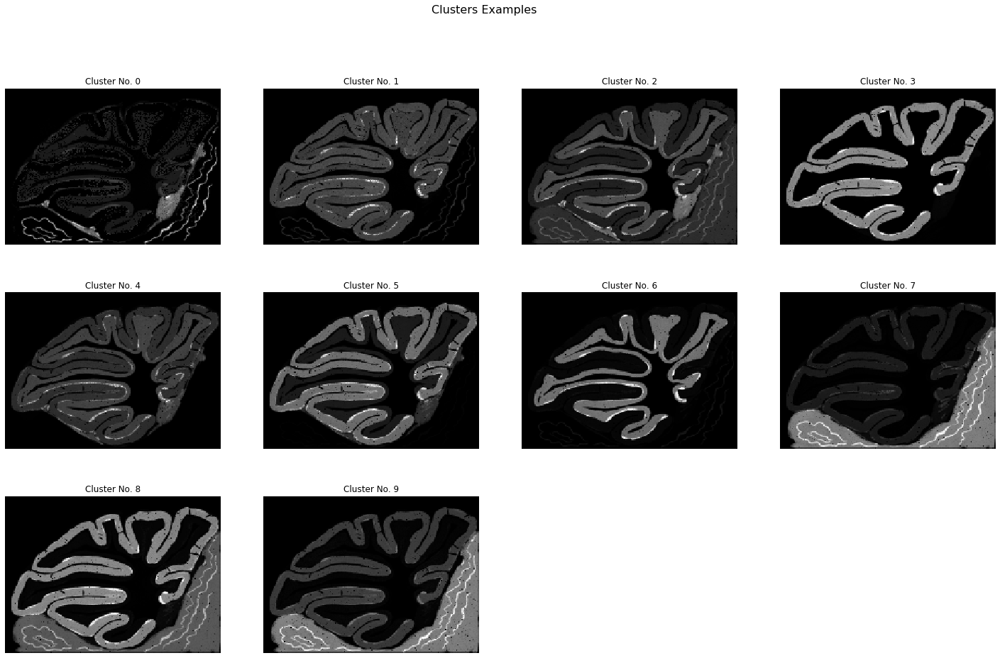

In [ ]:
clusters_preview(a2, y_km10)

In [ ]:
km_labels, km_sils = [], []
for i in tqdm(range(2, 15)):
    km = KMeans(n_clusters = i, n_jobs = -1)
    y_km = km.fit_predict(data2)
    km_labels.append(y_km)
    km_sils.append(silhouette_score(data2, y_km))

100%|██████████| 13/13 [06:43<00:00, 31.06s/it]


In [ ]:
for i in range(len(km_sils)):
    print('No. of clusters = {0}, sil_score = {1}'.format(i+2, np.round(km_sils[i],2)))

No. of clusters = 2, sil_score = 0.8399999737739563
No. of clusters = 3, sil_score = 0.8199999928474426
No. of clusters = 4, sil_score = 0.8299999833106995
No. of clusters = 5, sil_score = 0.7300000190734863
No. of clusters = 6, sil_score = 0.7400000095367432
No. of clusters = 7, sil_score = 0.7200000286102295
No. of clusters = 8, sil_score = 0.699999988079071
No. of clusters = 9, sil_score = 0.699999988079071
No. of clusters = 10, sil_score = 0.699999988079071
No. of clusters = 11, sil_score = 0.7099999785423279
No. of clusters = 12, sil_score = 0.6700000166893005
No. of clusters = 13, sil_score = 0.6399999856948853
No. of clusters = 14, sil_score = 0.6299999952316284


In [ ]:
Counter(km_labels[9])

Counter({1: 1468,
         4: 71,
         9: 118,
         10: 26,
         7: 21,
         2: 3,
         0: 52,
         5: 25,
         3: 3,
         6: 1,
         8: 6})

In [ ]:
Counter(km_labels[0])

Counter({1: 1685, 0: 109})

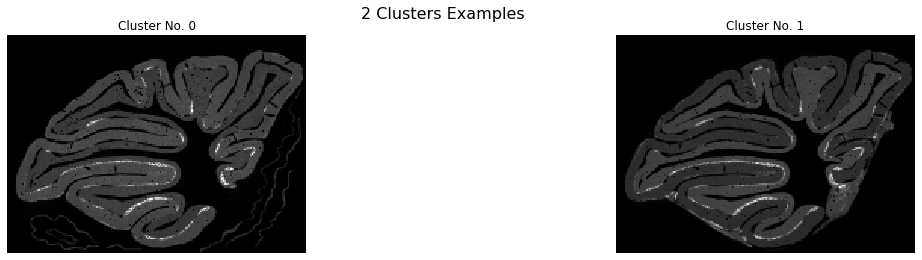

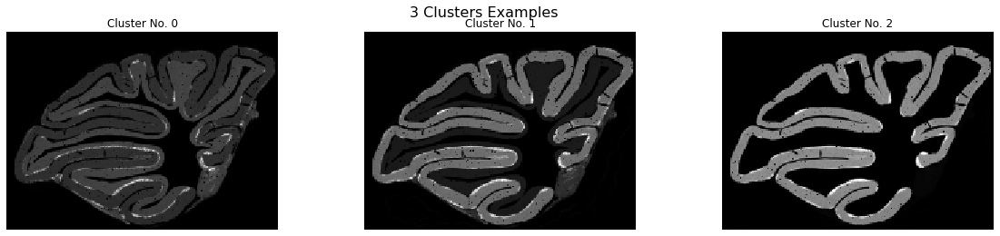

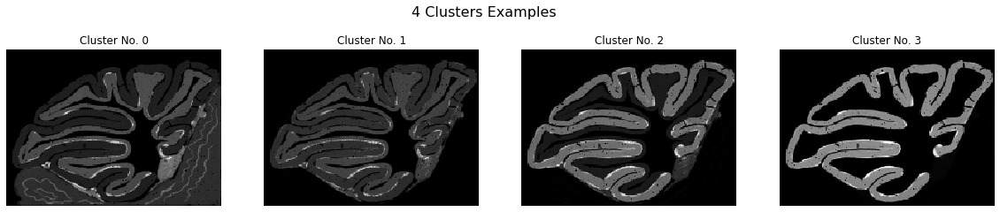

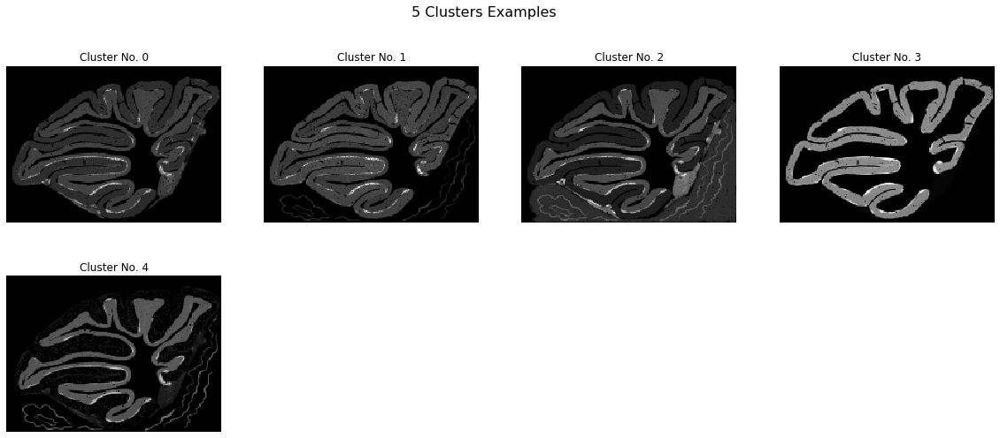

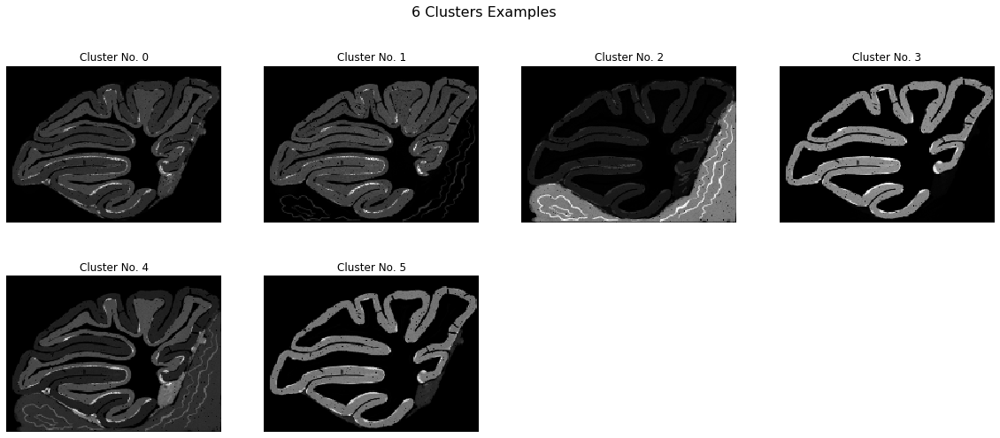

...

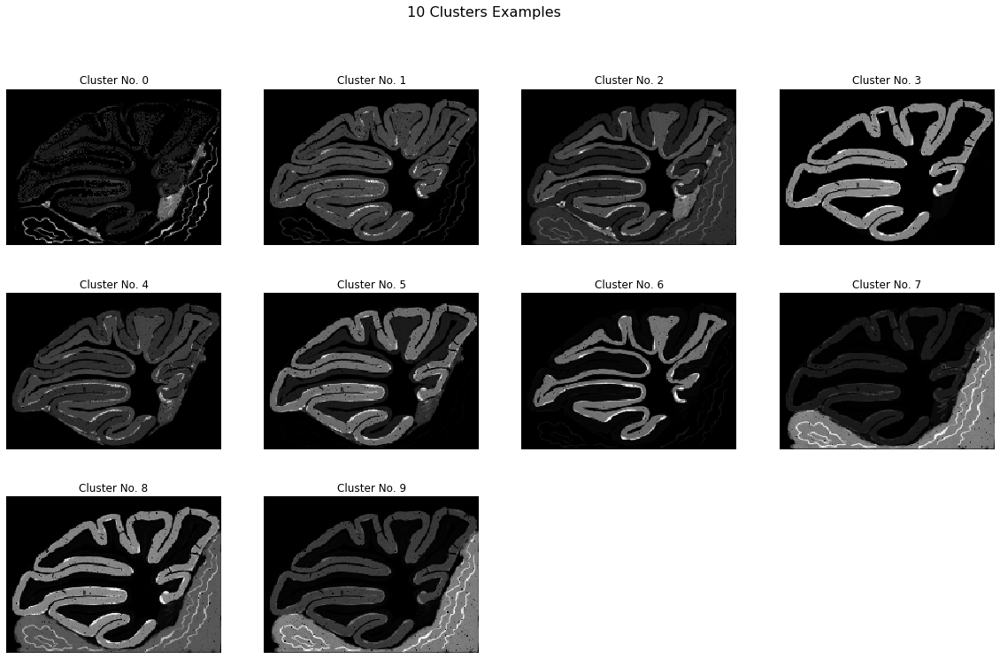

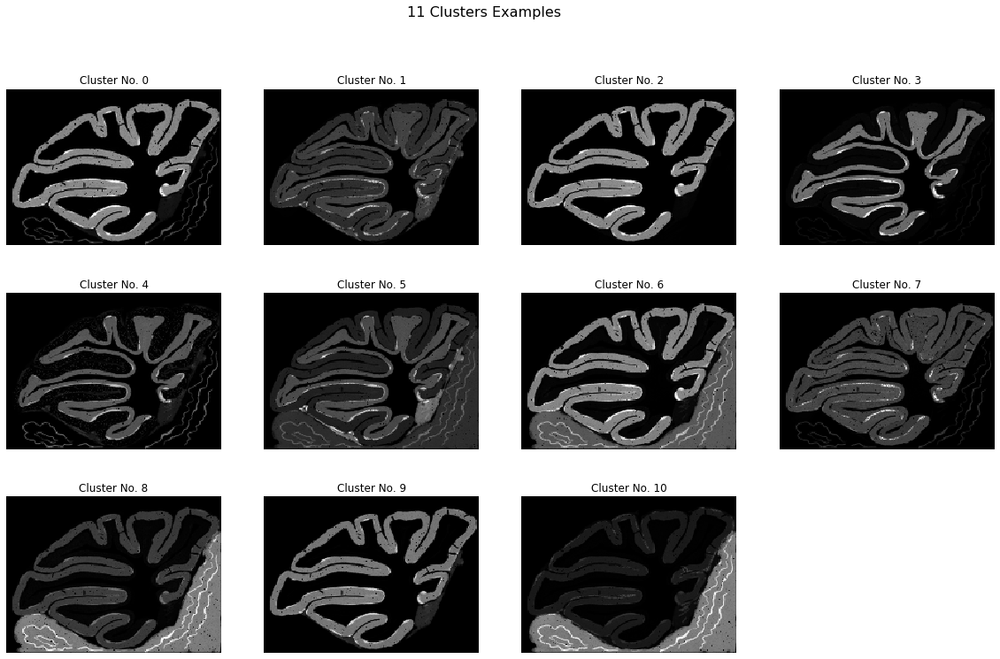

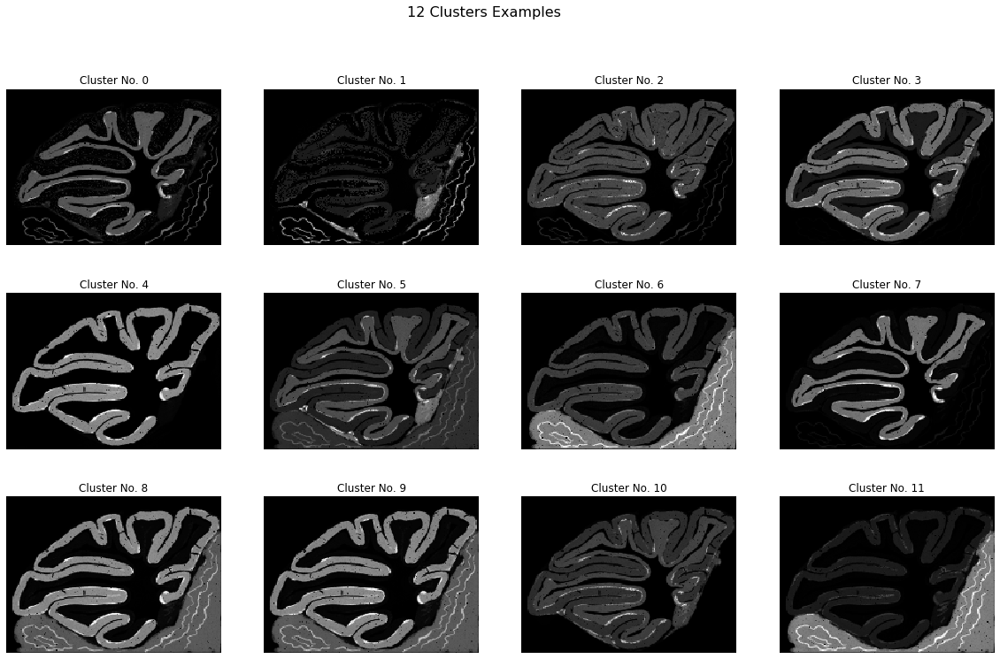

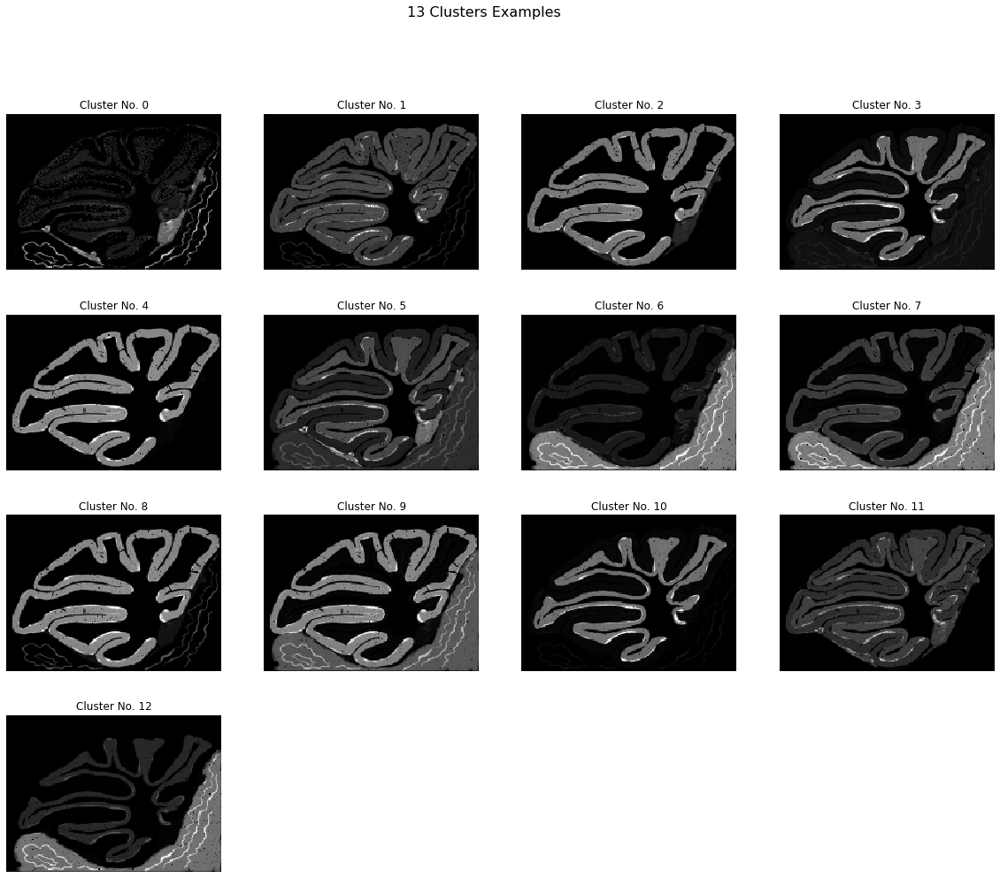

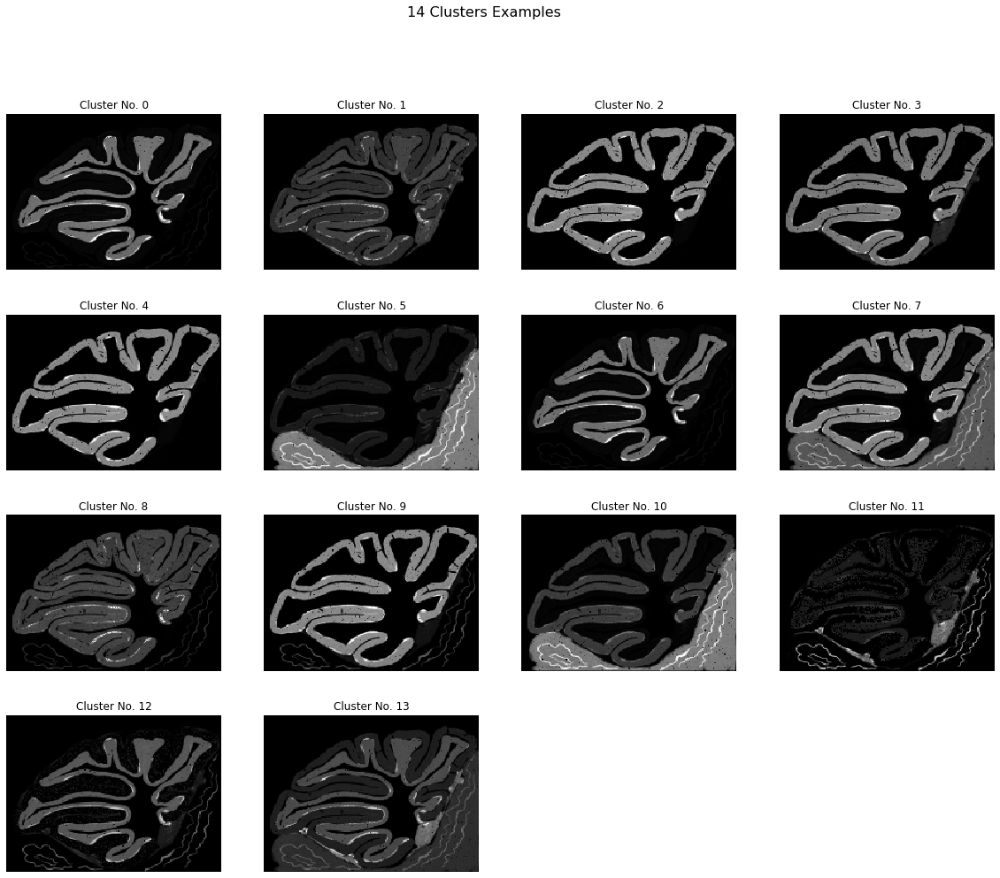

In [ ]:
for i in range(len(km_labels)):
    clusters_preview(a2, km_labels[i], i+2)
    plt.show()

## OPTICS

In [ ]:
y_op = OPTICS(min_samples=2).fit_predict(data2)

/Users/toma/opt/anaconda3/lib/python3.7/site-packages/sklearn/cluster/_optics.py:802: RuntimeWarning: divide by zero encountered in true_divide
  ratio = reachability_plot[:-1] / reachability_plot[1:]


In [ ]:
Counter(y_op)

Counter({-1: 970,
         102: 2,
         257: 2,
         210: 2,
         13: 3,
         81: 2,
         254: 4,
         215: 4,
         247: 2,
         169: 2,
         195: 3,
         105: 9,
         291: 2,
         92: 5,
         306: 3,
         134: 4,
         269: 3,
         160: 3,
         96: 8,
         113: 6,
         184: 3,
         174: 3,
         64: 5,
         251: 4,
         189: 3,
         246: 2,
         241: 3,
         250: 3,
         2: 2,
         181: 3,
         110: 3,
         115: 4,
         167: 2,
         190: 2,
         262: 3,
         231: 3,
         213: 2,
         176: 2,
         150: 2,
         99: 6,
         31: 4,
         214: 2,
         104: 3,
         144: 4,
         100: 3,
         307: 2,
         116: 2,
         252: 2,
         271: 3,
         220: 2,
         221: 3,
         154: 5,
         299: 3,
         197: 5,
         12: 4,
         278: 2,
         83: 2,
         217: 3,
         128: 3,
       

In [ ]:
len(np.unique(y_op))

309

In [ ]:
y_op1 = OPTICS(min_samples=10).fit_predict(data2)

In [ ]:
Counter(y_op1)

Counter({-1: 1522,
         4: 47,
         7: 16,
         3: 85,
         6: 29,
         2: 23,
         0: 18,
         5: 10,
         8: 15,
         1: 16,
         9: 13})

In [ ]:
OPTICS(min_samples=10).get_params

<bound method BaseEstimator.get_params of OPTICS(algorithm='auto', cluster_method='xi', eps=None, leaf_size=30,
       max_eps=inf, metric='minkowski', metric_params=None,
       min_cluster_size=None, min_samples=10, n_jobs=None, p=2,
       predecessor_correction=True, xi=0.05)>

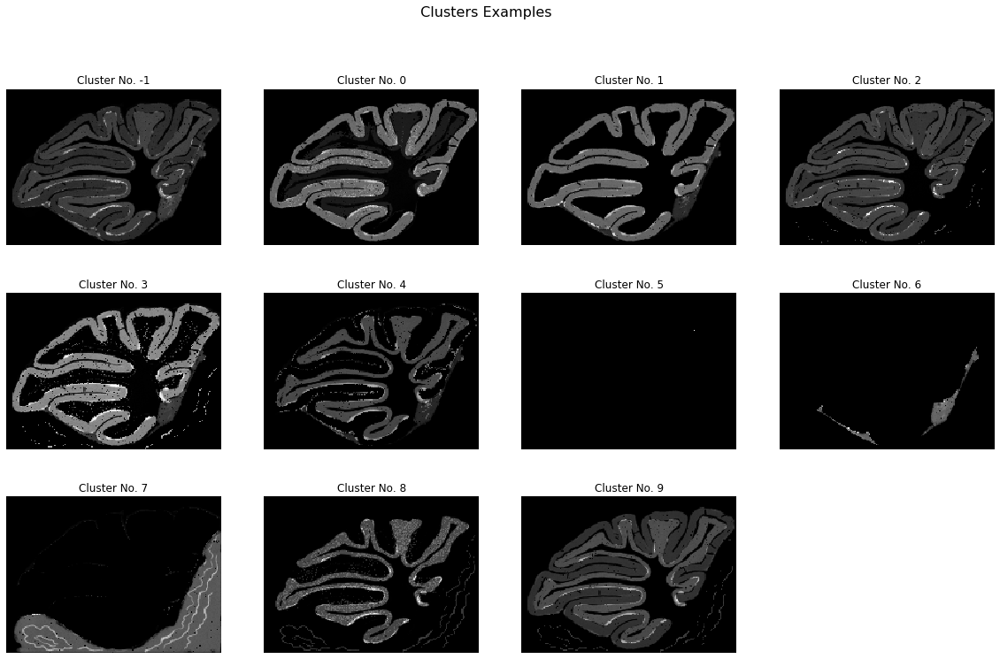

In [ ]:
clusters_preview(a2, y_op1)

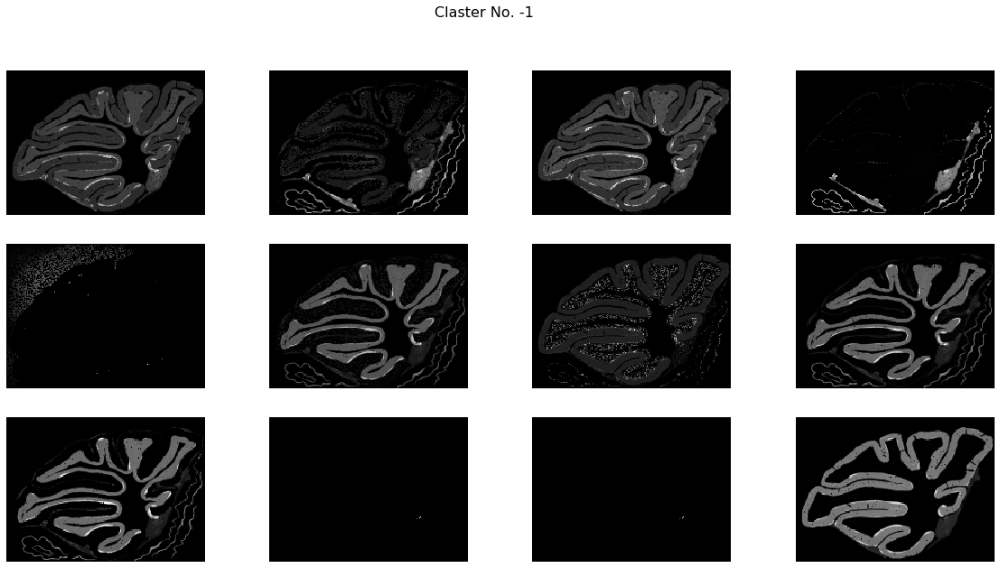

In [ ]:
show_cluster(a2, y_op1, -1)

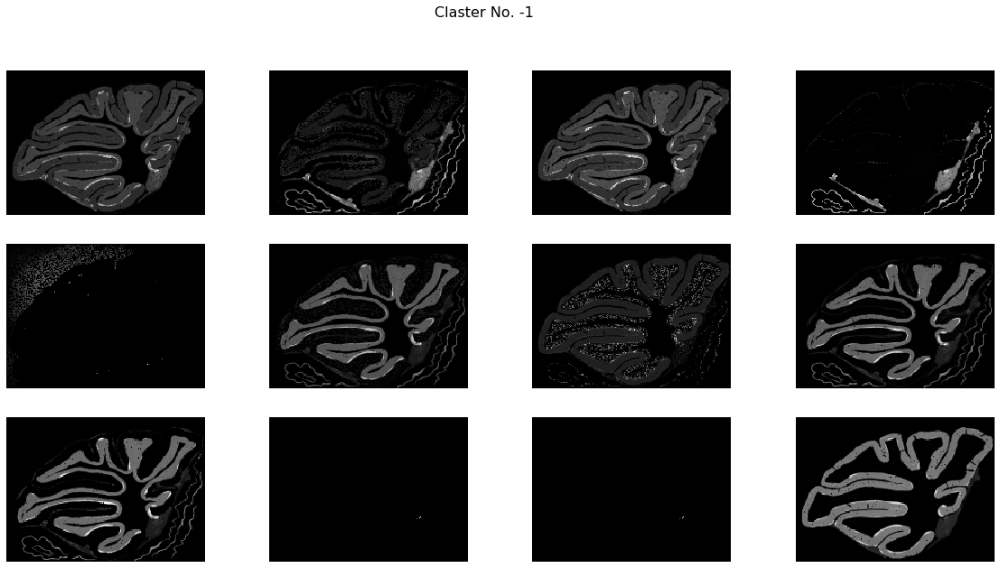

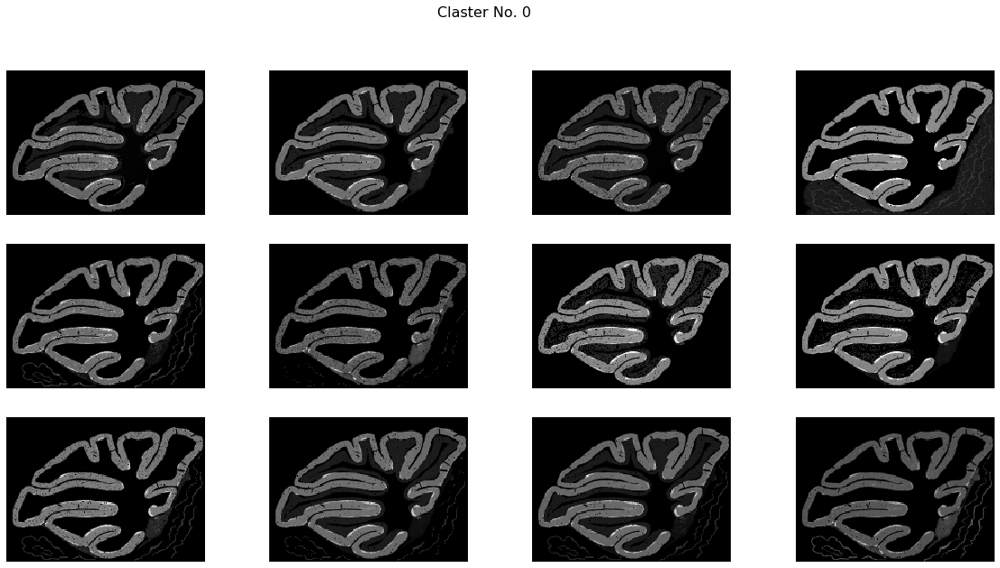

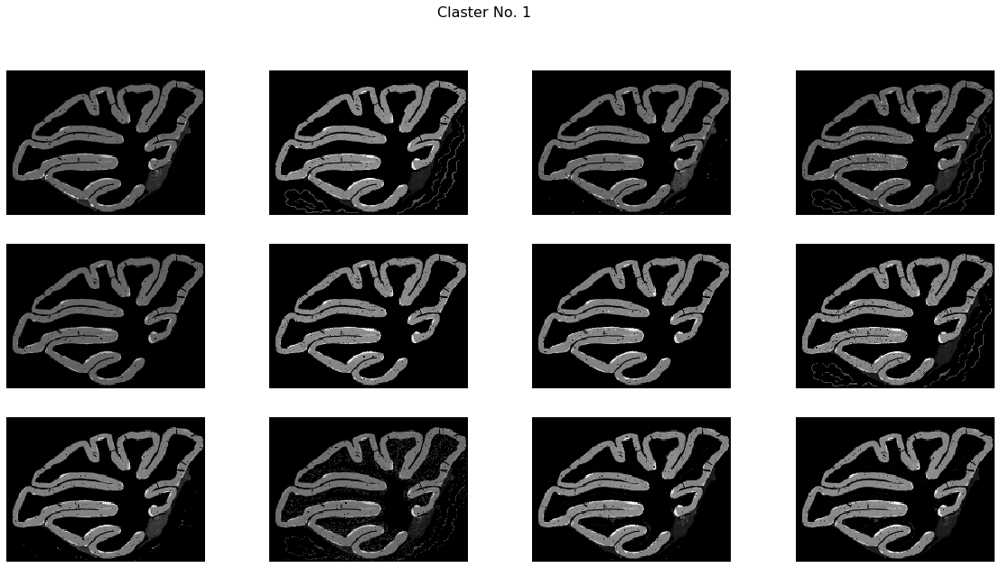

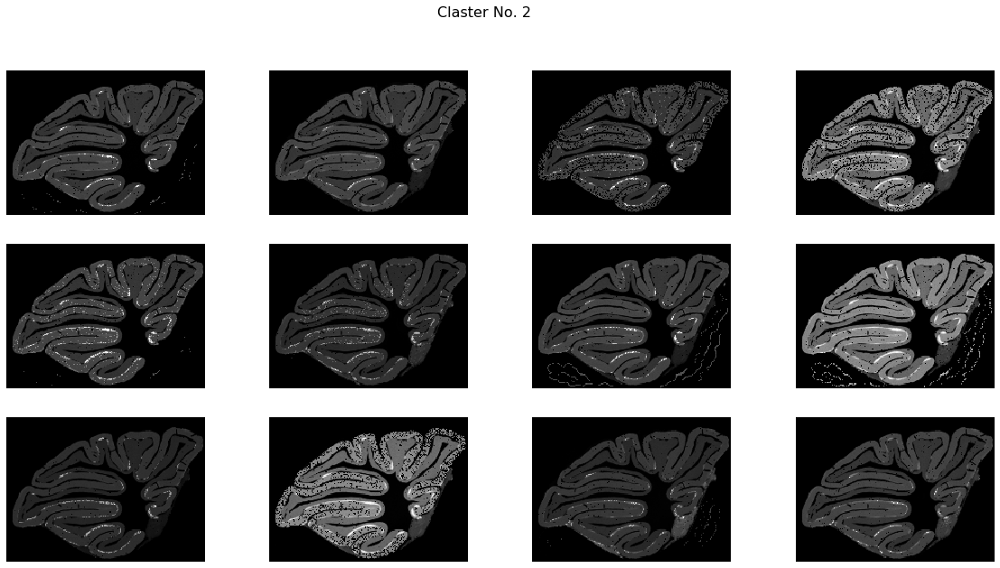

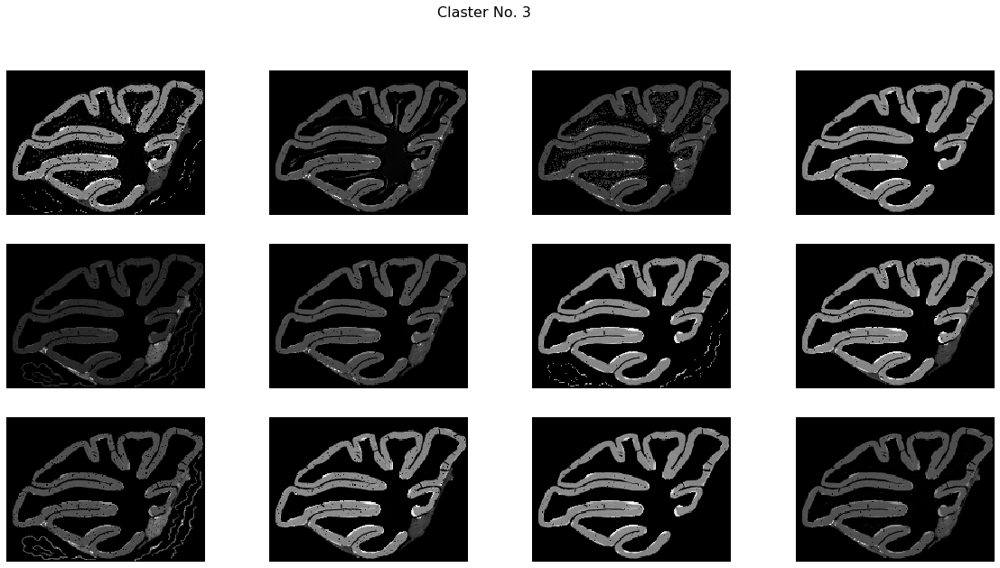

...

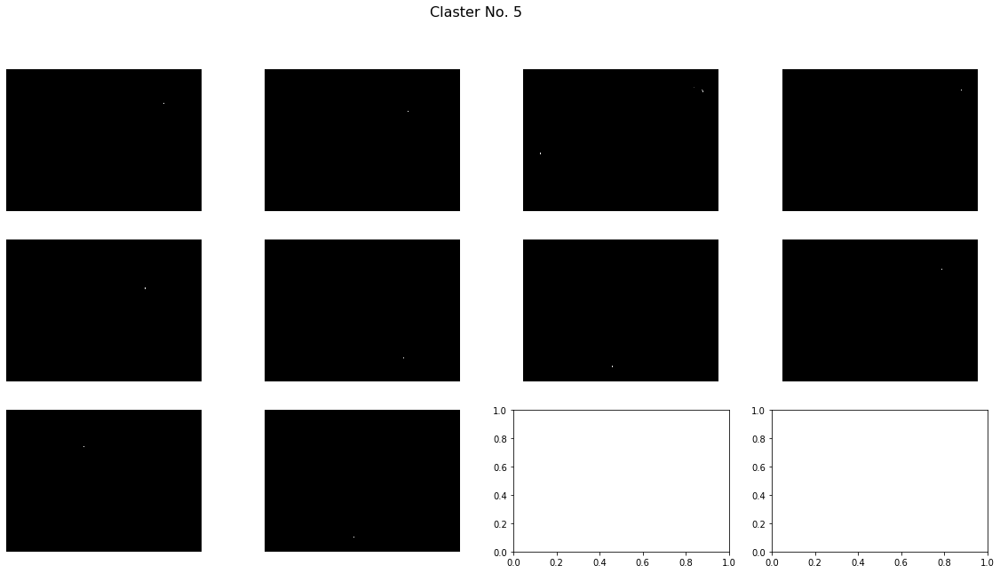

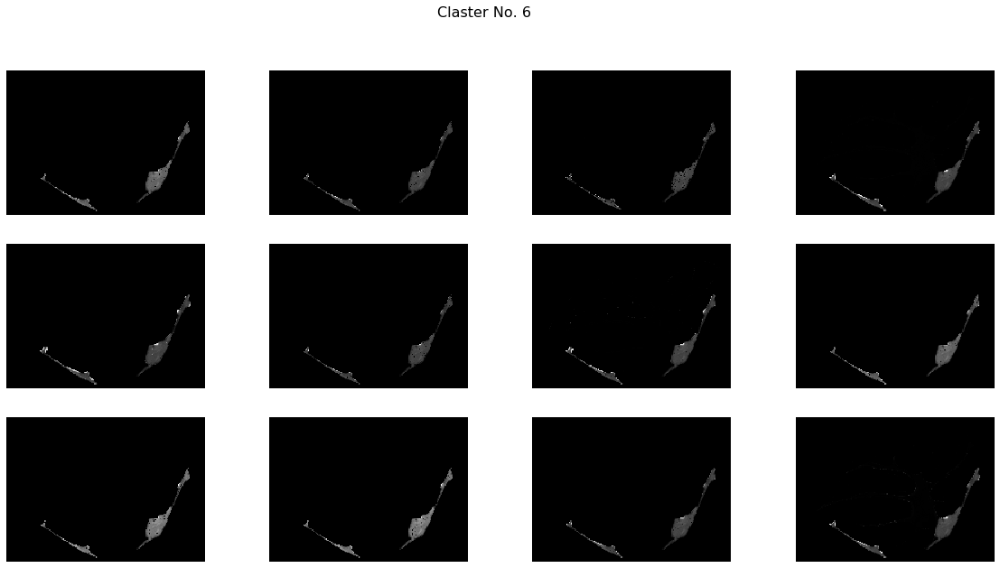

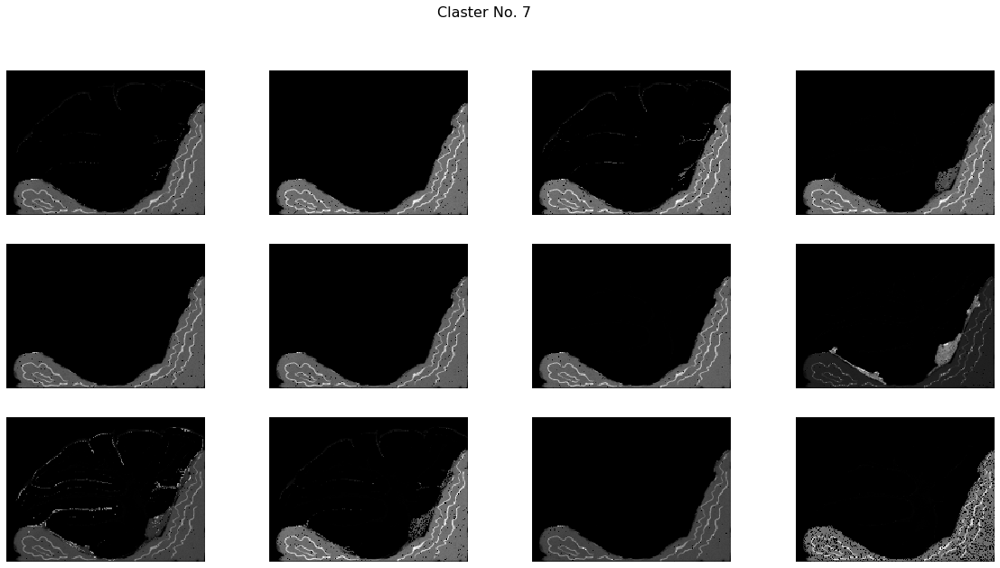

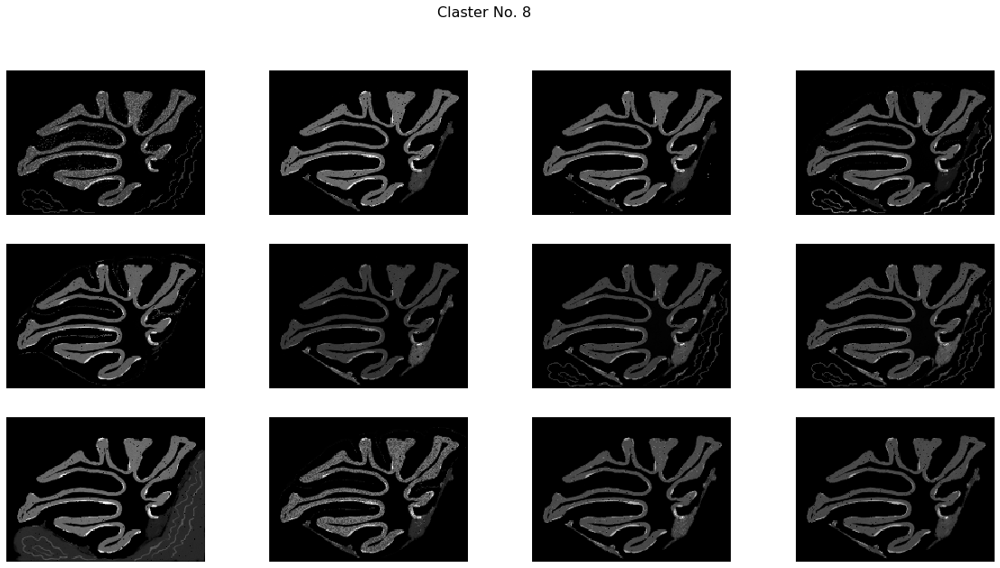

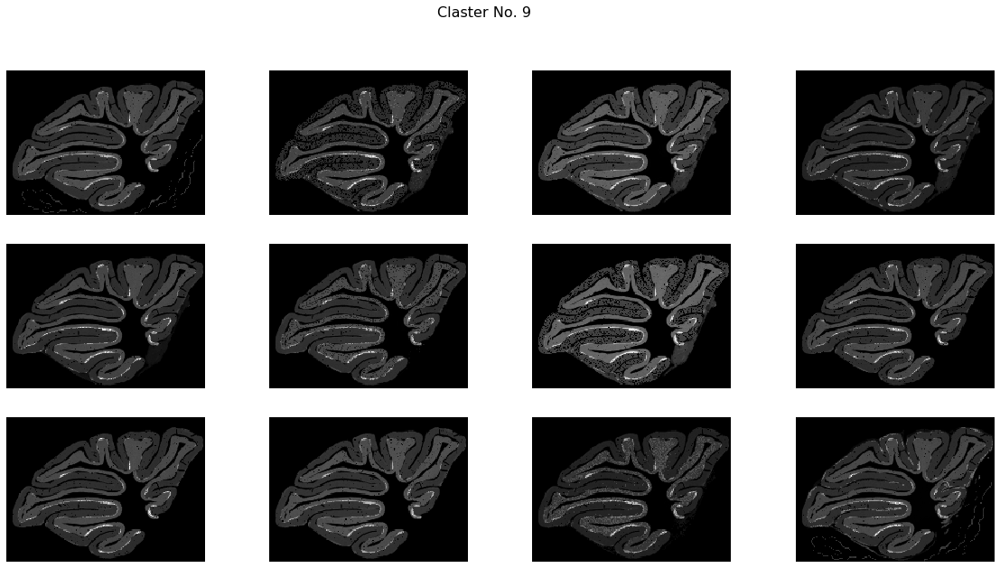

In [ ]:
for i in range(len(np.unique(y_op1))):
    show_cluster(a2, y_op1, i-1)
    plt.show()

## HDBSCAN

In [ ]:
!pip install --quiet --upgrade hdbscan
import hdbscan

In [ ]:
hdb = hdbscan.HDBSCAN()

In [ ]:
y_hdbscan = hdb.fit_predict(data2)

In [ ]:
Counter(y_hdbscan)

Counter({-1: 1287,
         0: 5,
         1: 8,
         2: 7,
         3: 7,
         4: 8,
         5: 5,
         6: 10,
         7: 5,
         8: 20,
         9: 39,
         10: 13,
         11: 22,
         12: 84,
         13: 9,
         14: 5,
         15: 7,
         16: 14,
         17: 47,
         18: 15,
         19: 10,
         20: 8,
         21: 31,
         22: 5,
         23: 118,
         24: 5})

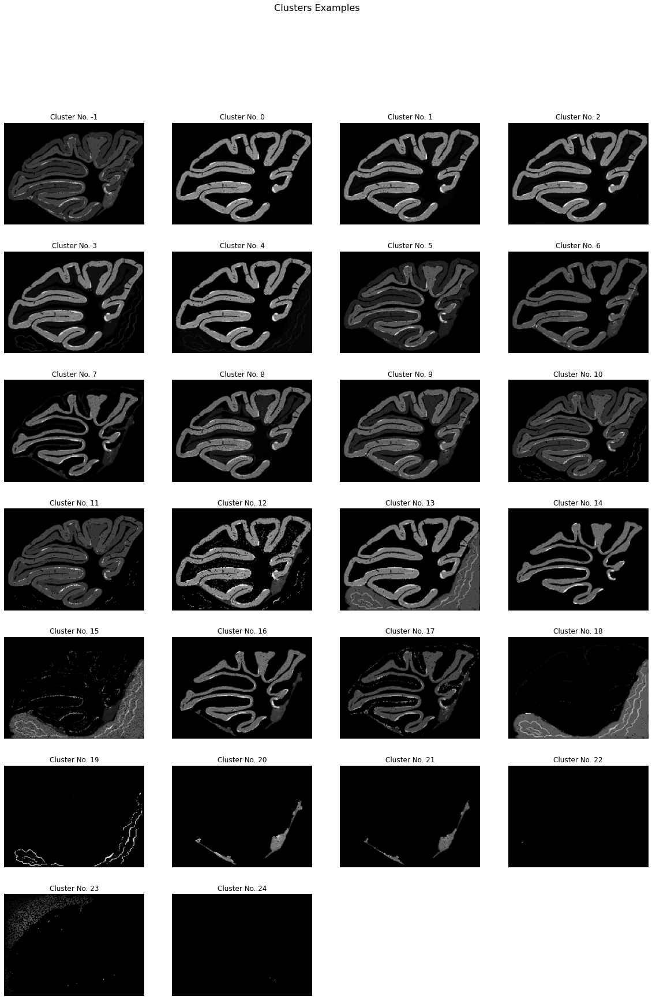

In [ ]:
clusters_preview(a2, y_hdbscan)

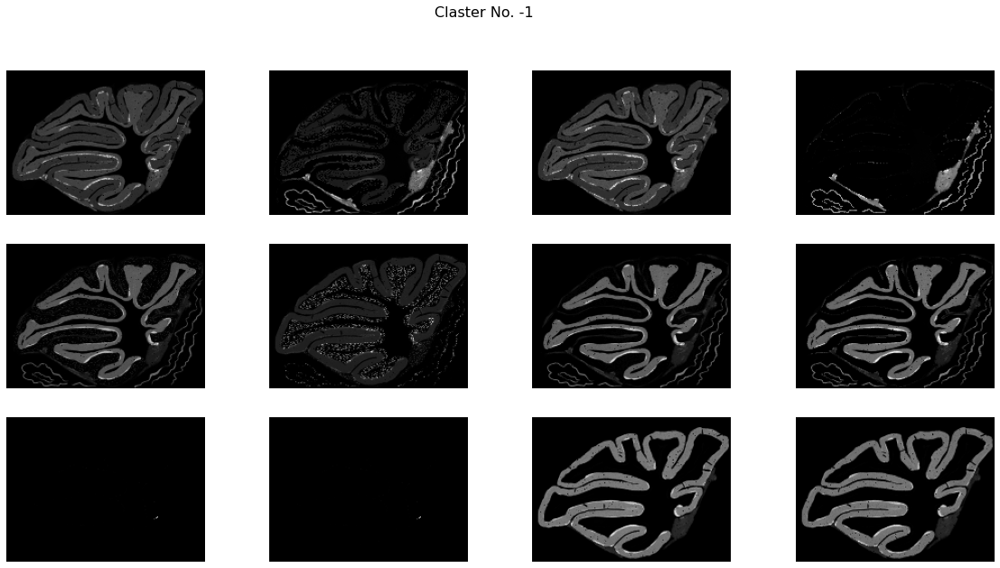

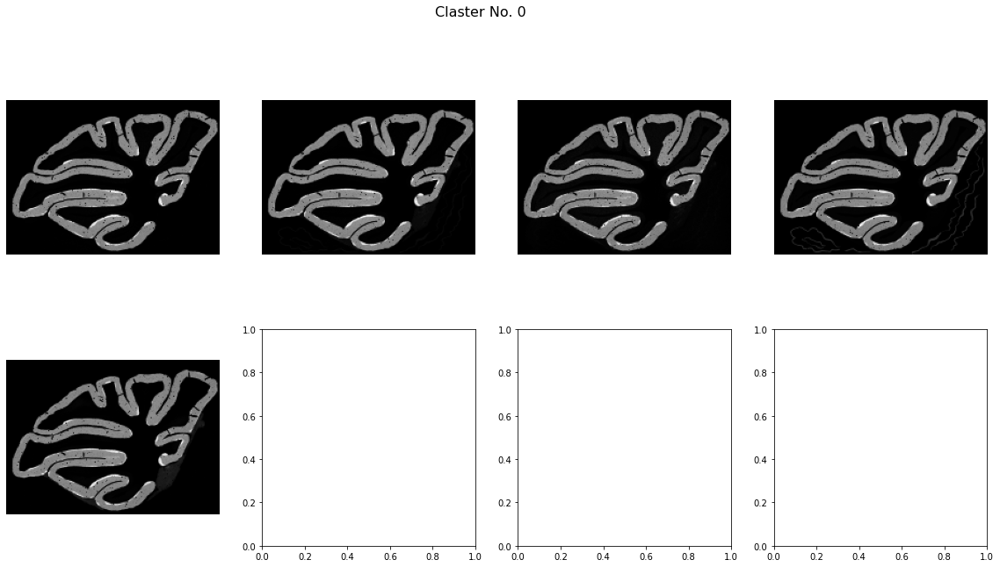

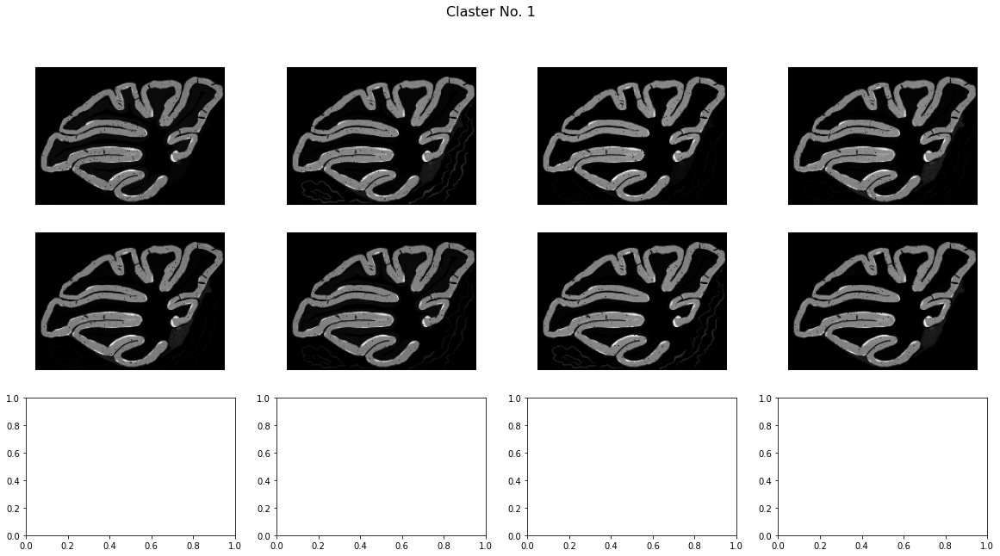

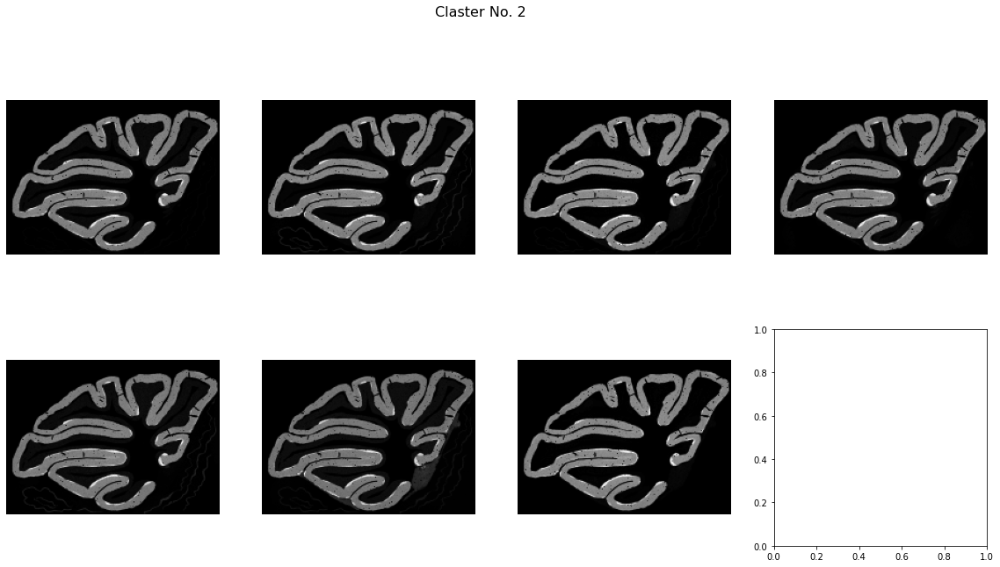

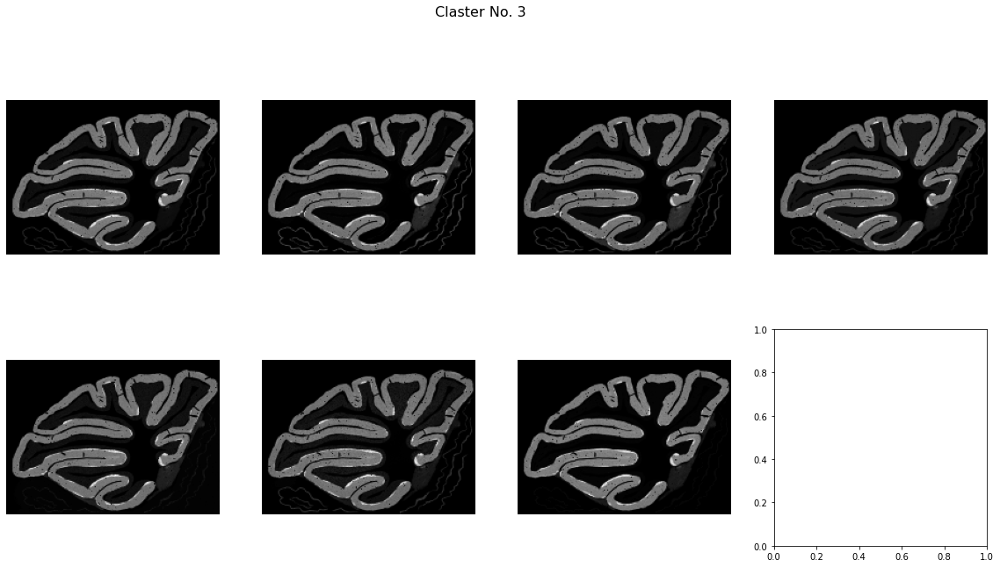

...

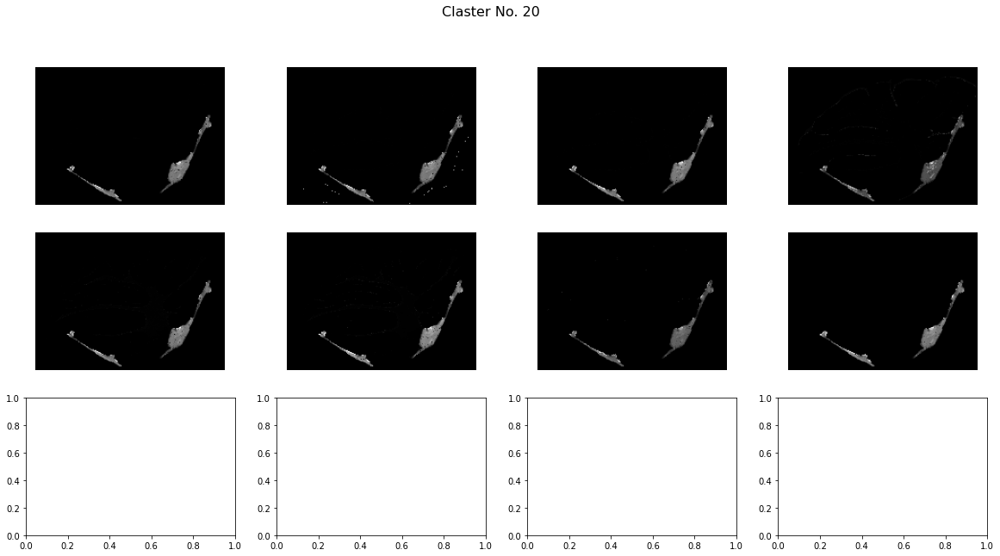

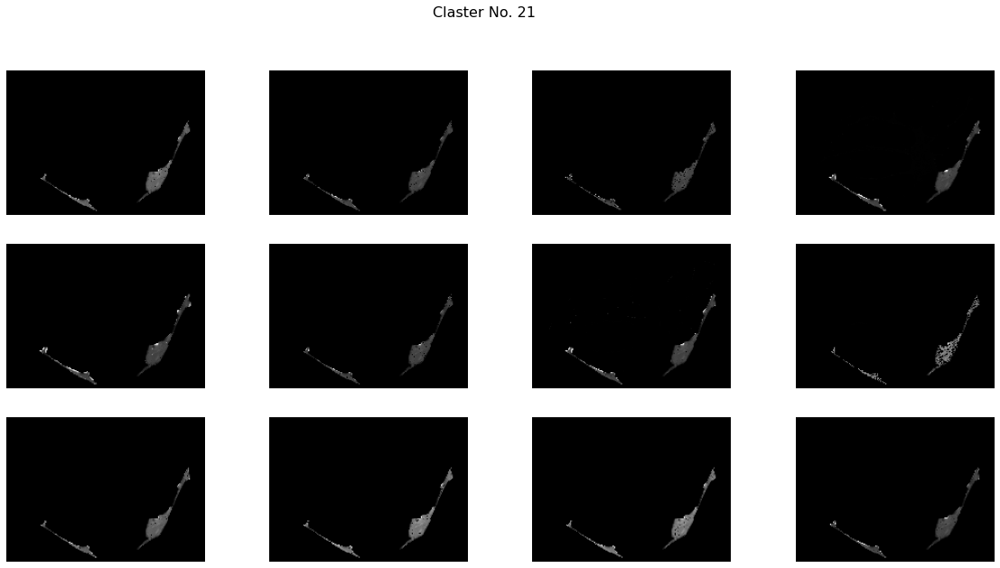

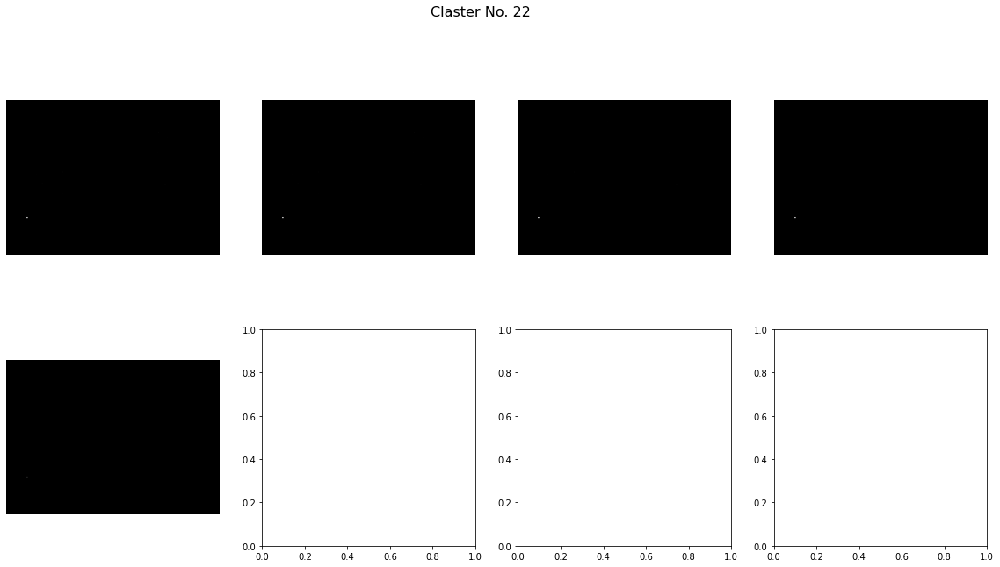

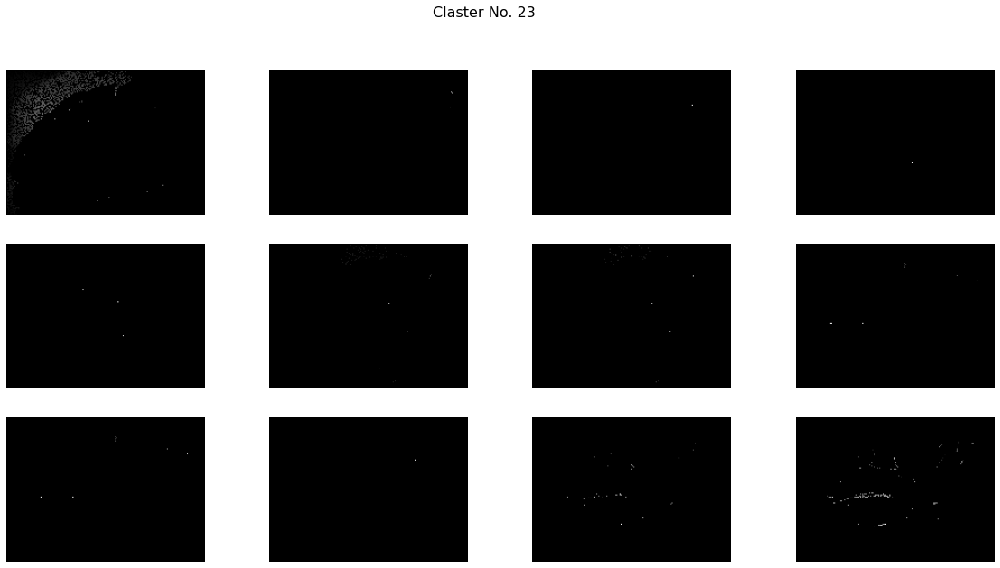

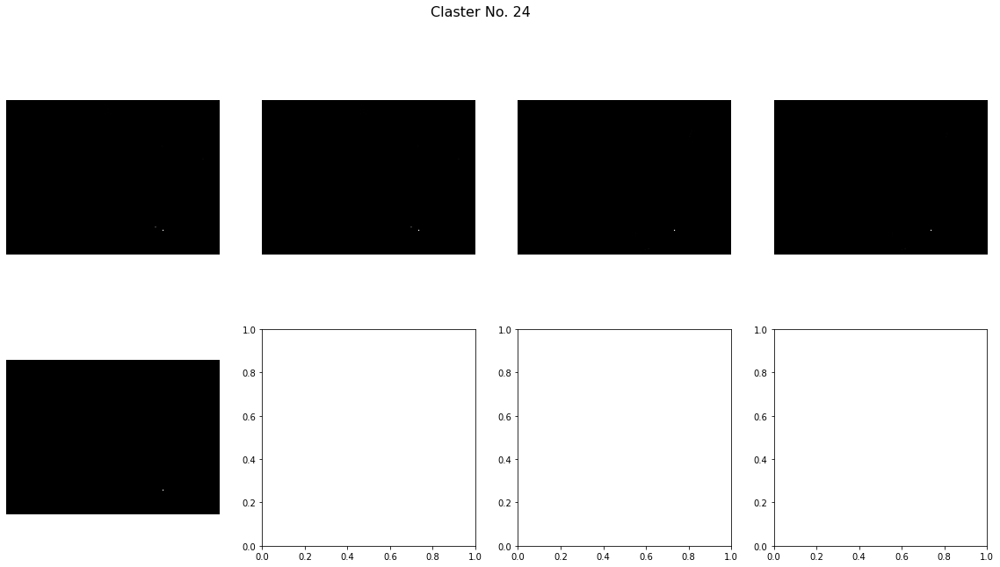

In [ ]:
for i in range(len(np.unique(y_hdbscan))):
    show_cluster(a2, y_hdbscan, i-1)
    plt.show()

## PCA

We can see that all methods have one major cluster - cluster "-1". So most of the images are not identified. That is why we continue to examine data further and try to extract more features for clustering. Here I have tried to use PCA. Again, the results were lost but I have discovered that we can sqeeze the dimensions to 20. But clustering on the pca data didn't give us any new results (and took a loooot time to compute).

In [ ]:
from sklearn.decomposition import PCA

In [ ]:
im = a2[0]#.reshape(1,-1)

In [ ]:
im.shape

(144, 198)

In [ ]:
expl_var = []
for i in range(im.shape[0]):
    pca = PCA(n_components=i)
    pca.fit(im)
    expl_var.append(pca.explained_variance_ratio_)

In [ ]:
expl_vars = [np.sum(i) for i in expl_var]

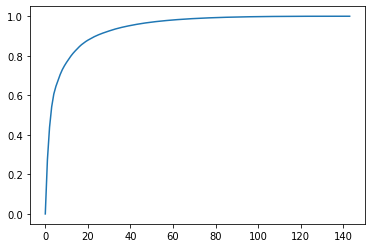

In [ ]:
plt.plot(expl_vars)

In [ ]:
data2.shape

(1794, 28512)

In [ ]:
expl_var2 = []
for i in range(data2.shape[0]):
    pca = PCA(n_components=i)
    pca.fit(data2)
    expl_var2.append(pca.explained_variance_ratio_)

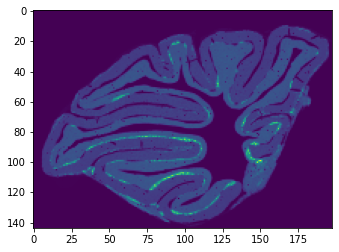

## Kernels

I have also decided to use some CV methods for features generation. Convolving them with kernels provided new features. But clustering only on the new features didn't bring any new results. Clustering on all new images has brokrn the kernel. 

### Blur

In [ ]:
blur_k = np.array([[0.0625, 0.125, 0.0625], [0.125, 0.25, 0.125], [0.0625, 0.125, 0.0625]])

In [ ]:
blur_k

array([[0.0625, 0.125 , 0.0625],
       [0.125 , 0.25  , 0.125 ],
       [0.0625, 0.125 , 0.0625]])

### Prewitt

In [ ]:
rewitt

### Bottom sobel

In [ ]:
bot_sobel_k = np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]])
left_sobel_k = np.array([[1, 0, -1], [2, 0, -2], [1, 0, -1]])
right_sobel_k = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
top_sobel_k = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]])

In [ ]:
print(bot_sobel_k, '\n\n',left_sobel_k, '\n\n', right_sobel_k, '\n\n', top_sobel_k)

[[-1 -2 -1]
 [ 0  0  0]
 [ 1  2  1]] 

 [[ 1  0 -1]
 [ 2  0 -2]
 [ 1  0 -1]] 

 [[-1  0  1]
 [-2  0  2]
 [-1  0  1]] 

 [[ 1  2  1]
 [ 0  0  0]
 [-1 -2 -1]]


### Emboss

In [ ]:
emboss_k = np.array([[-2,-1, 0], [-1, 1, 1], [0, 1, 2]])

In [ ]:
emboss_k

array([[-2, -1,  0],
       [-1,  1,  1],
       [ 0,  1,  2]])

### Outline

In [ ]:
outline_k = np.array([[-1, -1, -1], [-1, 8, -1], [-1, -1, -1]])

In [ ]:
outline_k

array([[-1, -1, -1],
       [-1,  8, -1],
       [-1, -1, -1]])

### Sharpen

In [ ]:
sharpen_k = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])

In [ ]:
sharpen_k

array([[ 0, -1,  0],
       [-1,  5, -1],
       [ 0, -1,  0]])

## Autoencoder

Spoiler: autoencoder didn't perform well in encoding but subsequent clusterinп has finally braught us even clusters. However, there are to many of them. Maybe we can work with this and improve this further (choose clustering with defined number of lusters and find the optimal one).
VAE was hard to train (due to decaying gradients and weights) but normalizing data and the smallest learning rate have allowed us to get decent results. VAE works extremely good but... Clustering works in the worst way possible :((
SGD with nesterov momentum was used for better optimization.
[Comet ML](https://www.comet.ml/tama-ts/final-project/view/new) link to track my bizar experiments.

In [ ]:
import numpy as np
import torch
from torch import nn
import torch.nn.functional as F
import torch.optim as optim
from IPython import display
import torch.utils.data as data_utils
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
data2.shape

(1794, 28512)

In [ ]:
X_train = data2

In [ ]:
train = data_utils.TensorDataset(torch.Tensor(X_train), torch.zeros(X_train.shape[0],)) # pseudo labels needed to define TensorDataset
train_loader = data_utils.DataLoader(train, batch_size=20, shuffle=True)

In [ ]:
dimZ = 50 # sizw of the bottleneck

class Autoencoder(nn.Module):
    def __init__(self, bottleneck = dimZ):
        super(Autoencoder, self).__init__()
        
        self.bottleneck = bottleneck
        def init_weights(m):
          if type(m) == nn.Linear:
            torch.nn.init.xavier_uniform_(m.weight, gain=1.0)
            m.bias.data.fill_(0)

        self.encoder = nn.Sequential(nn.Linear(28512, 10000), nn.ReLU(), nn.Linear(10000, 5000), nn.ReLU(),
                                     nn.Linear(5000, 1000), nn.ReLU(), nn.Linear(1000, self.bottleneck), nn.ReLU())
        self.encoder.apply(init_weights)

        self.decoder = nn.Sequential(nn.Linear(self.bottleneck, 1000), nn.ReLU(), nn.Linear(1000, 5000), nn.ReLU(), 
                                     nn.Linear(5000, 10000), nn.ReLU(), nn.Linear(10000, 28512), nn.Sigmoid())
        self.decoder.apply(init_weights)
        
    def forward(self, x):
        
        latent_code = self.encoder(x)

        reconstruction = self.decoder(latent_code)
        
        return reconstruction, latent_code

In [ ]:
# Create MSE loss function
criterion = torch.nn.MSELoss()

autoencoder = Autoencoder().cuda()

optimizer = torch.optim.SGD(autoencoder.parameters(), lr = 0.005, momentum = 0.1, dampening = 0, nesterov=True) #optim.Adam(autoencoder.parameters(), lr = 0.001)

In [ ]:
n_epochs = 20

In [ ]:
experiment.set_name("4 layers encoder, 20 epochs, lr = 0.005, bot_neck = 50 (radical measures!), batch_size = 20 (was 50), new otimizer - SGD with nesterov momentum(now 0.5)")

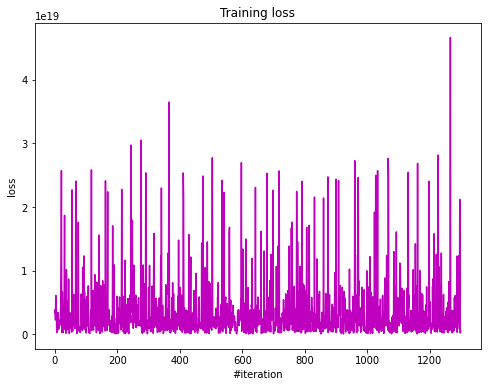

[Epoch 20/20] [Batch 65/100] [Loss: 500920833141637120.000000]


In [ ]:
losses = []
image_progress = []
for epoch in range(n_epochs):
  i = 0
  for X, y in train_loader:
    i += 1
    optimizer.zero_grad()
    X = X.cuda()
    out_reconstr, out_latent = autoencoder.forward(X)
    loss = criterion(out_reconstr, X)
    loss.backward()
    losses.append(loss.detach())
    optimizer.step()

    experiment.log_epoch_end(epoch)
    experiment.log_metric("train_mse_loss", loss.detach())
    display.clear_output(wait=True)
    plt.figure(figsize=(8, 6))
    


    plt.title("Training loss")
    plt.xlabel("#iteration")
    plt.ylabel("loss")
    plt.plot(losses, 'm')
    plt.show()            
    print(
        "[Epoch %d/%d] [Batch %d/%d] [Loss: %f]"
        % (epoch+1, n_epochs, i, 100, loss.item()))

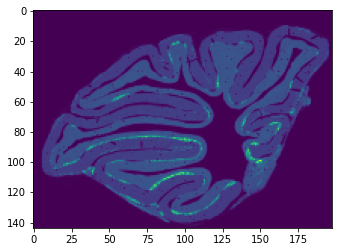

In [ ]:
plt.imshow(data2[0].reshape(144,-1))

In [ ]:
image = torch.Tensor(data2[0]).cuda()

In [ ]:
result, _ = autoencoder(image)
result = result.data.cpu().numpy()

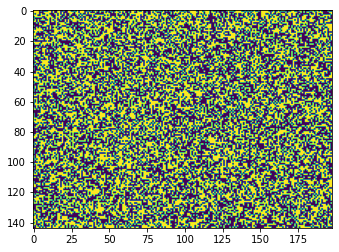

In [ ]:
plt.imshow(result.reshape(144, -1))

### Latent representations

In [ ]:
lat = autoencoder.encoder(torch.Tensor(data2).cuda()).cpu().detach().numpy()

In [ ]:
lat.shape

(1794, 50)

In [ ]:
!pip install --quiet --upgrade hdbscan
import hdbscan

In [ ]:
hdb = hdbscan.HDBSCAN()

In [ ]:
y_hdb = hdb.fit_predict(lat)

In [ ]:
from collections import Counter

In [ ]:
Counter(y_hdb)

Counter({-1: 421,
         0: 5,
         1: 22,
         2: 14,
         3: 8,
         4: 12,
         5: 7,
         6: 7,
         7: 14,
         8: 13,
         9: 11,
         10: 18,
         11: 16,
         12: 6,
         13: 11,
         14: 9,
         15: 5,
         16: 7,
         17: 13,
         18: 21,
         19: 6,
         20: 19,
         21: 18,
         22: 12,
         23: 12,
         24: 18,
         25: 29,
         26: 34,
         27: 6,
         28: 6,
         29: 7,
         30: 10,
         31: 5,
         32: 15,
         33: 17,
         34: 8,
         35: 9,
         36: 8,
         37: 7,
         38: 27,
         39: 10,
         40: 14,
         41: 7,
         42: 13,
         43: 10,
         44: 7,
         45: 6,
         46: 9,
         47: 11,
         48: 9,
         49: 15,
         50: 16,
         51: 11,
         52: 6,
         53: 17,
         54: 14,
         55: 6,
         56: 9,
         57: 7,
         58: 8,
         59: 15,

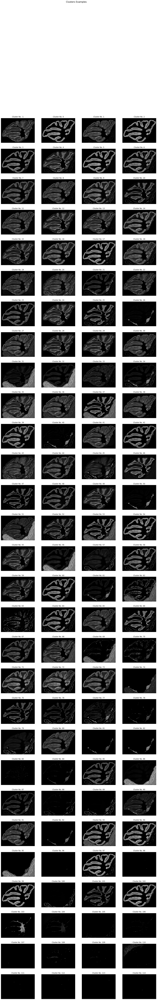

In [ ]:
clusters_preview(a2, y_hdb)

## AE on normed data

In [ ]:
X_train_norm = X_train/np.max(X_train, axis = 1).reshape(-1, 1)

In [ ]:
train = data_utils.TensorDataset(torch.Tensor(X_train_norm), torch.zeros(X_train.shape[0],)) # pseudo labels needed to define TensorDataset
train_loader = data_utils.DataLoader(train, batch_size=20, shuffle=True)

In [ ]:
dimZ = 50 # sizw of the bottleneck

class Autoencoder(nn.Module):
    def __init__(self, bottleneck = dimZ):
        super(Autoencoder, self).__init__()
        
        self.bottleneck = bottleneck
        def init_weights(m):
          if type(m) == nn.Linear:
            torch.nn.init.xavier_uniform_(m.weight, gain=1.0)
            m.bias.data.fill_(0)

        self.encoder = nn.Sequential(nn.Linear(28512, 10000), nn.ReLU(), nn.Linear(10000, 5000), nn.ReLU(),
                                     nn.Linear(5000, 1000), nn.ReLU(), nn.Linear(1000, self.bottleneck), nn.ReLU())
        self.encoder.apply(init_weights)

        self.decoder = nn.Sequential(nn.Linear(self.bottleneck, 1000), nn.ReLU(), nn.Linear(1000, 5000), nn.ReLU(), 
                                     nn.Linear(5000, 10000), nn.ReLU(), nn.Linear(10000, 28512), nn.Sigmoid())
        self.decoder.apply(init_weights)
        
    def forward(self, x):
        
        latent_code = self.encoder(x)

        reconstruction = self.decoder(latent_code)
        
        return reconstruction, latent_code

In [ ]:
# Create MSE loss function
criterion = torch.nn.MSELoss()

autoencoder = Autoencoder().cuda()

optimizer = torch.optim.SGD(autoencoder.parameters(), lr = 0.00001, momentum = 0.1, dampening = 0, nesterov=True) #optim.Adam(autoencoder.parameters(), lr = 0.001)

In [ ]:
n_epochs = 20

In [ ]:
experiment.set_name("4 layers encoder, Normed data!, 20 epochs, lr = 0.00001, bot_neck = 50 (radical measures!), batch_size = 20 (was 50), new otimizer - SGD with nesterov momentum(now 0.5)")

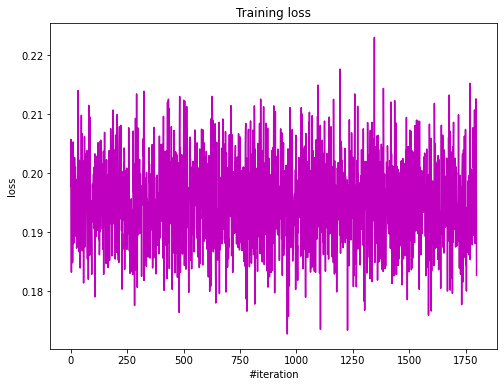

[Epoch 20/20] [Batch 90/100] [Loss: 0.182678]


In [ ]:
losses = []
image_progress = []
for epoch in range(n_epochs):
  i = 0
  for X, y in train_loader:
    i += 1
    optimizer.zero_grad()
    X = X.cuda()
    out_reconstr, out_latent = autoencoder.forward(X)
    loss = criterion(out_reconstr, X)
    loss.backward()
    losses.append(loss.detach())
    optimizer.step()

    experiment.log_epoch_end(epoch)
    experiment.log_metric("train_mse_loss", loss.detach())
    display.clear_output(wait=True)
    plt.figure(figsize=(8, 6))
    


    plt.title("Training loss")
    plt.xlabel("#iteration")
    plt.ylabel("loss")
    plt.plot(losses, 'm')
    plt.show()            
    print(
        "[Epoch %d/%d] [Batch %d/%d] [Loss: %f]"
        % (epoch+1, n_epochs, i, 100, loss.item()))

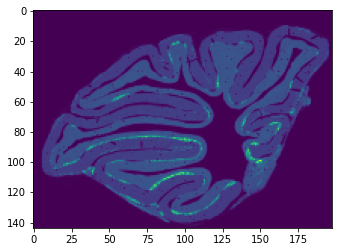

In [ ]:
plt.imshow(data2[0].reshape(144,-1))

In [ ]:
image = torch.Tensor(data2[0]).cuda()

In [ ]:
result = autoencoder(image)
result = result.data.cpu().numpy()

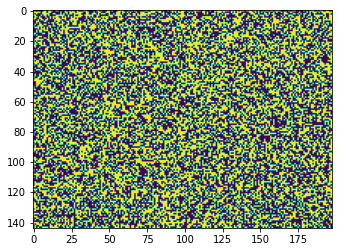

In [ ]:
plt.imshow(result.reshape(144, -1))

## VAE

In [ ]:
X_train_norm = X_train/np.max(X_train, axis = 1).reshape(-1, 1)

In [ ]:
train = data_utils.TensorDataset(torch.Tensor(X_train_norm), torch.zeros(X_train_norm.shape[0],)) # pseudo labels needed to define TensorDataset
train_loader = data_utils.DataLoader(train, batch_size=20, shuffle=True)

In [ ]:
class VAE(nn.Module):
    def __init__(self):
        super(VAE, self).__init__()
        
        def init_weights(m):
          if type(m) == nn.Linear:
            torch.nn.init.xavier_uniform_(m.weight, gain=0.1)
            m.bias.data.fill_(0)

        self.encoder_1 = nn.Sequential(nn.Linear(28512, 10000), nn.ReLU(), nn.Linear(10000, 5000), nn.ReLU(),
                                     nn.Linear(5000, 1000), nn.ReLU())#, nn.Linear(1000, self.bottleneck), nn.ReLU())
        self.encoder_21 = nn.Linear(1000, 50)
        self.encoder_22 = nn.Linear(1000, 50)
        # self.encoder_1.apply(init_weights)
        # self.encoder_21.apply(init_weights)
        # self.encoder_22.apply(init_weights)

        self.decoder = nn.Sequential(nn.Linear(50, 1000), nn.ReLU(), nn.Linear(1000, 5000), nn.ReLU(), 
                                     nn.Linear(5000, 10000), nn.ReLU(), nn.Linear(10000, 28512), nn.Sigmoid())
        # self.decoder.apply(init_weights)

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std)
        return mu + eps*std
        
    def forward(self, x):
        
        x_out = self.encoder_1(x)
        mu, logvar = self.encoder_21(x_out), self.encoder_22(x_out)
        z = self.reparameterize(mu, logvar)

        return self.decoder(z), mu, logvar

In [ ]:
def loss_function(recon_x, x, mu, logvar):
    BCE = F.binary_cross_entropy(recon_x, x, reduction='sum')
    KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

    return BCE + KLD

In [ ]:
model = VAE().cuda()

optimizer = torch.optim.SGD(model.parameters(), lr = 0.00001, momentum = 0.1, dampening = 0, nesterov=True) #optim.Adam(autoencoder.parameters(), lr = 0.001)

In [ ]:
n_epochs = 20

In [ ]:
experiment.set_name("VAE, 20 epochs, lr = 0.00001, bot_neck = 50 (radical measures!), batch_size = 20 (was 50), new otimizer - SGD with nesterov momentum(now 0.5)")

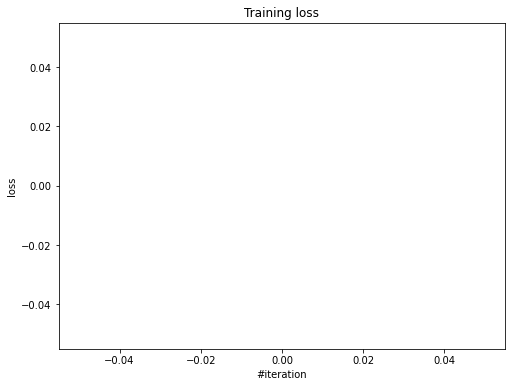

[Epoch 20/20] [Batch 90/100] [Loss: 71250.679688]


In [ ]:
losses = []
image_progress = []
for epoch in range(n_epochs):
  i = 0
  train_loss = 0
  for X, y in train_loader:
    i += 1
    optimizer.zero_grad()
    X = X.cuda()
    recon_batch, mu, logvar = model(X)
    loss = loss_function(recon_batch, X, mu, logvar)
    loss.backward()
    train_loss += loss.item()
    optimizer.step()

    experiment.log_epoch_end(epoch)
    experiment.log_metric("train_mse_loss", loss.detach())
    display.clear_output(wait=True)
    plt.figure(figsize=(8, 6))
    


    plt.title("Training loss")
    plt.xlabel("#iteration")
    plt.ylabel("loss")
    plt.plot(train_loss, 'm')
    plt.show()            
    print(
        "[Epoch %d/%d] [Batch %d/%d] [Loss: %f]"
        % (epoch+1, n_epochs, i, 100, loss.item()))

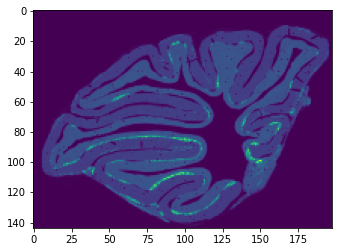

In [ ]:
plt.imshow(data2[0].reshape(144,-1))

In [ ]:
image = torch.Tensor(X_train_norm[0]).cuda()

In [ ]:
resultvae = model(image)
resultvae = resultvae[0].detach().cpu().numpy()

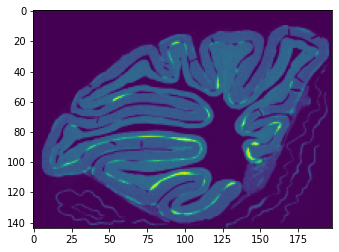

In [ ]:
plt.imshow(resultvae.reshape(144, -1))

### Latent representations

In [ ]:
x_out = model.encoder_1(torch.Tensor(X_train_norm).cuda())
mu, logvar = model.encoder_21(x_out), model.encoder_22(x_out)
z = model.reparameterize(mu, logvar)

In [ ]:
lat = z.cpu().detach().numpy()

In [ ]:
lat.shape

(1794, 50)

In [ ]:
!pip install --quiet --upgrade hdbscan
import hdbscan

In [ ]:
hdb = hdbscan.HDBSCAN()

In [ ]:
y_hdb_vae = hdb.fit_predict(lat)

In [ ]:
from collections import Counter

In [ ]:
Counter(y_hdb_vae)

Counter({-1: 542, 0: 11, 1: 13, 2: 1228})

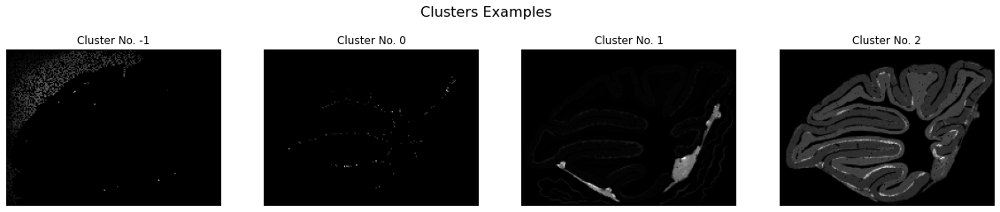

In [ ]:
clusters_preview(a2, y_hdb_vae)

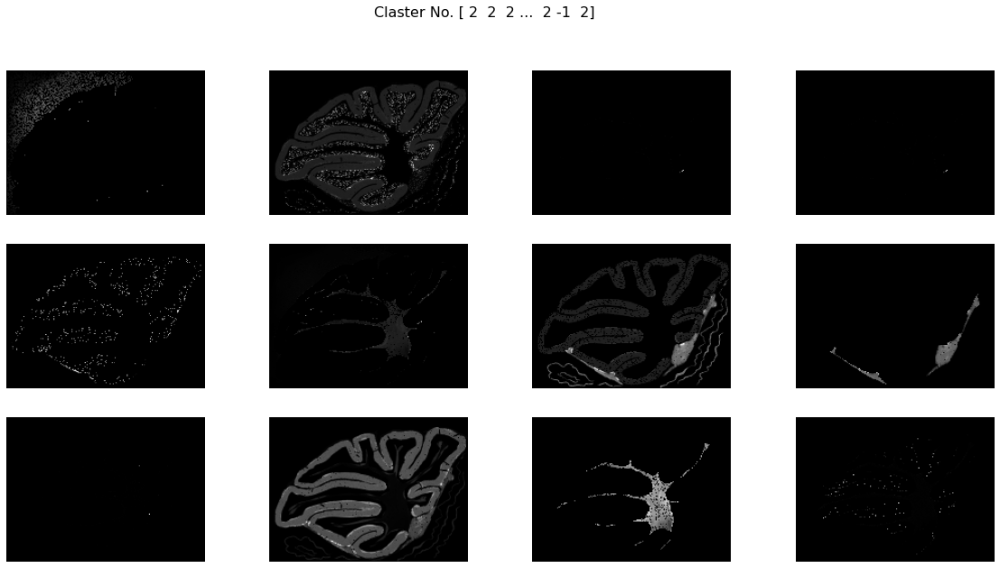

In [ ]:
show_cluster(a2, -1, y_hdb_vae)

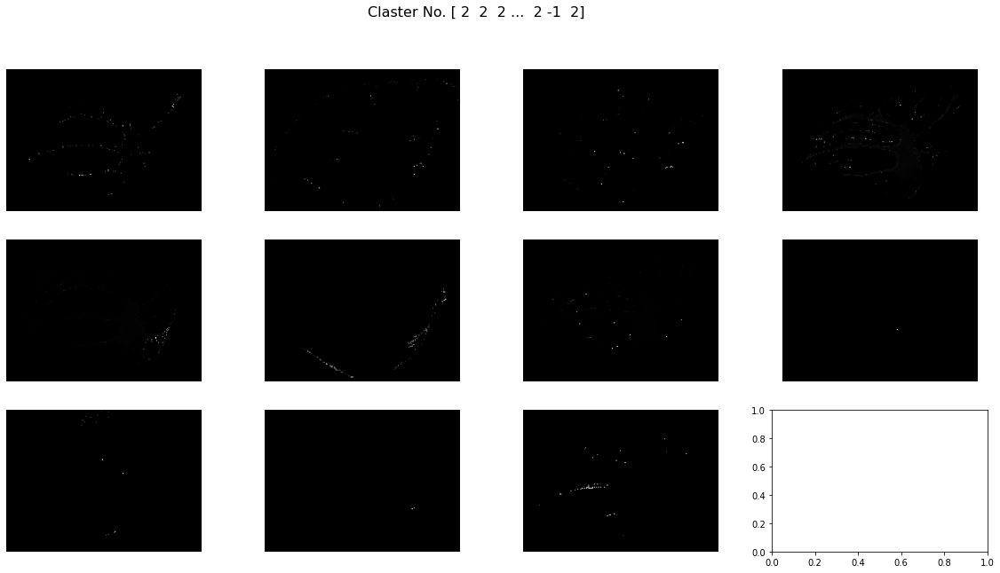

In [ ]:
show_cluster(a2, 0, y_hdb_vae)

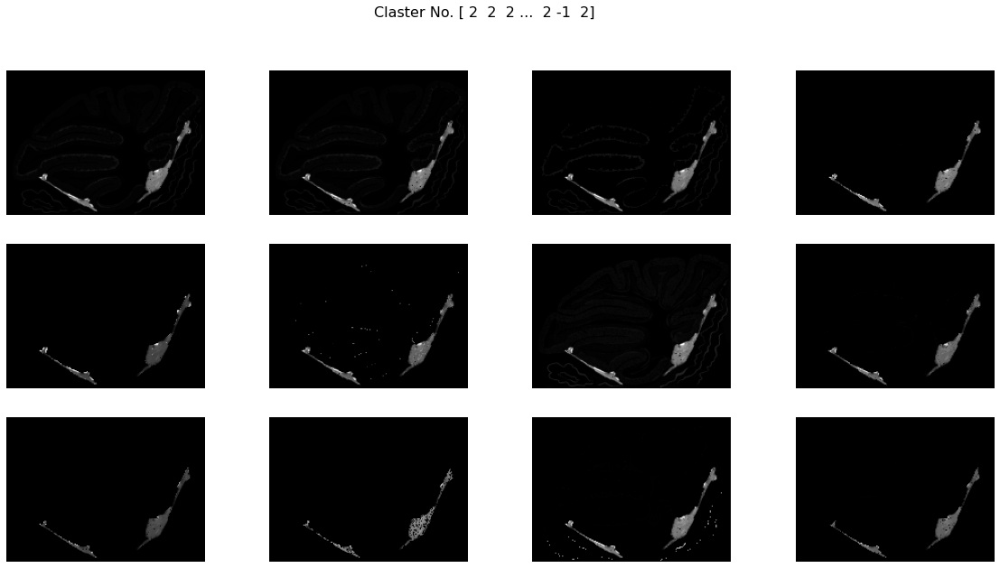

In [ ]:
show_cluster(a2, 1, y_hdb_vae)

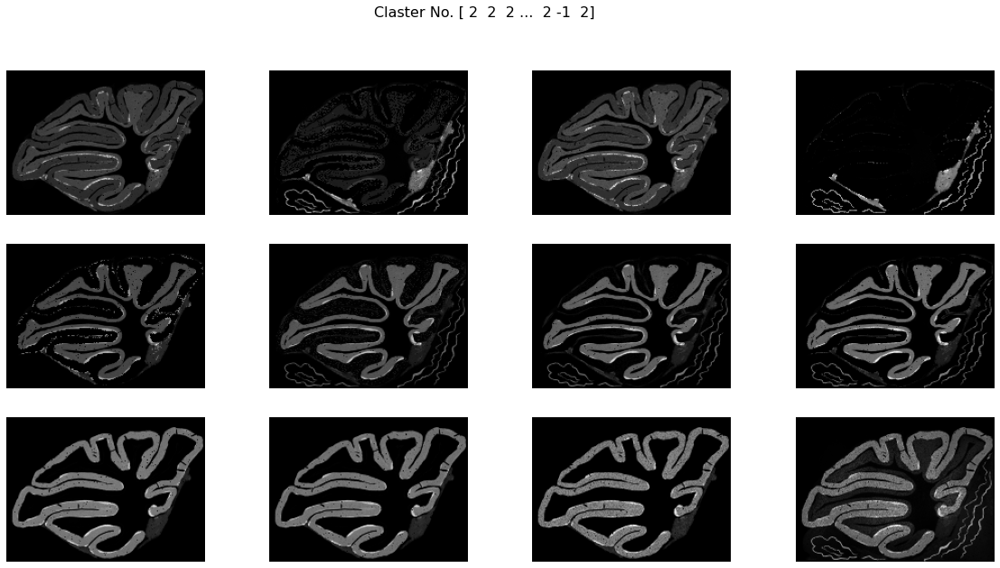

In [ ]:
show_cluster(a2, 2, y_hdb_vae)

## CNN for extracting deep feautures

(not ready)

The further idea was to build CNN or UNet on images to predict known mass over charge (m/z) and then use hidden layers for clustering. But unfortunately I didn't have enough time for this.


In [ ]:
X_train_a = a2

In [ ]:
train = data_utils.TensorDataset(torch.Tensor(X_train_a), torch.zeros(X_train_a.shape[0],)) # pseudo labels needed to define TensorDataset
train_loader = data_utils.DataLoader(train, batch_size=20, shuffle=True)

In [ ]:
class CNN(nn.Module):
    def __init__(self, bottleneck = dimZ):
        super(Autoencoder, self).__init__()
        
        def init_weights(m):
          if type(m) == nn.Linear:
            torch.nn.init.xavier_uniform_(m.weight, gain=1.0)
            m.bias.data.fill_(0)
        
        
    def forward(self, x):
        
        latent_code = self.encoder(x)

        reconstruction = self.decoder(latent_code)
        
        return reconstruction, latent_code

In [ ]:
# Create MSE loss function
criterion = torch.nn.MSELoss()

autoencoder = Autoencoder().cuda()

optimizer = torch.optim.SGD(autoencoder.parameters(), lr = 0.005, momentum = 0.1, dampening = 0, nesterov=True) #optim.Adam(autoencoder.parameters(), lr = 0.001)

In [ ]:
n_epochs = 20

In [ ]:
experiment.set_name("4 layers encoder, 20 epochs, lr = 0.005, bot_neck = 50 (radical measures!), batch_size = 20 (was 50), new otimizer - SGD with nesterov momentum(now 0.5)")

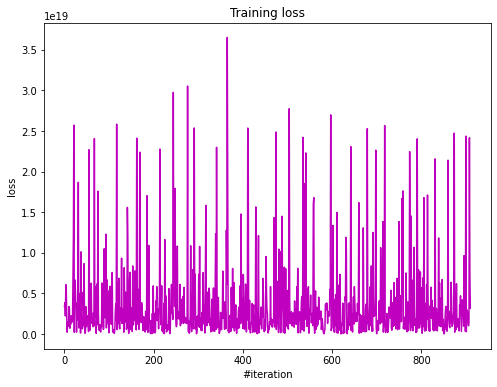

[Epoch 15/20] [Batch 1/100] [Loss: 3189015003986395136.000000]


In [ ]:
losses = []
image_progress = []
for epoch in range(n_epochs):
  i = 0
  for X, y in train_loader:
    i += 1
    optimizer.zero_grad()
    X = X.cuda()
    out_reconstr, out_latent = autoencoder.forward(X)
    loss = criterion(out_reconstr, X)
    loss.backward()
    losses.append(loss.detach())
    optimizer.step()

    experiment.log_epoch_end(epoch)
    experiment.log_metric("train_mse_loss", loss.detach())
    display.clear_output(wait=True)
    plt.figure(figsize=(8, 6))
    


    plt.title("Training loss")
    plt.xlabel("#iteration")
    plt.ylabel("loss")
    plt.plot(losses, 'm')
    plt.show()            
    print(
        "[Epoch %d/%d] [Batch %d/%d] [Loss: %f]"
        % (epoch+1, n_epochs, i, 100, loss.item()))

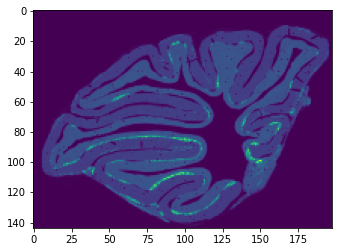

In [ ]:
plt.imshow(data2[0].reshape(144,-1))

In [ ]:
image = torch.Tensor(data2[0]).cuda()

In [ ]:
result, _ = autoencoder(image)
result = result.data.cpu().numpy()

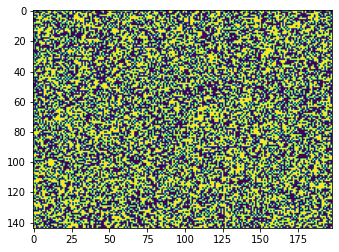

In [ ]:
plt.imshow(result.reshape(144, -1))